In [1]:
%cd /lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/dis2p_reproducibility

/lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/dis2p_reproducibility


In [2]:
# enable autoreload
%load_ext autoreload
%autoreload 2
%matplotlib inline

import os
import random

import scvi
scvi.settings.seed = 0
import scanpy as sc
import anndata as ad
import torch
import numpy as np
import pandas as pd
from datetime import datetime
from scipy.sparse import csr_matrix
torch.set_float32_matmul_precision('medium')
import warnings
warnings.simplefilter("ignore", UserWarning)
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import seaborn as sns

from celldisect import CellDISECT
from scvi.model.base import BaseModelClass
import rapids_singlecell as rsc

import scib

from sklearn.metrics import r2_score
from scipy.stats import pearsonr
import warnings
from tqdm import tqdm
warnings.filterwarnings("ignore")

Global seed set to 0
Global seed set to 0


In [3]:
adata = sc.read_h5ad('../kang_normalized_hvg.h5ad')
adata = adata[adata.layers['counts'].sum(1) != 0].copy()

In [4]:
adata.layers['counts'].max()

3828.0

In [5]:
adata.X.max()

3828.0

In [6]:
from typing import NamedTuple

class _REGISTRY_KEYS_NT(NamedTuple):
    X_KEY: str = "X"
    BATCH_KEY: str = "batch"
    LABELS_KEY: str = "labels"
    PROTEIN_EXP_KEY: str = "proteins"
    CAT_COVS_KEY: str = "extra_categorical_covs"
    CONT_COVS_KEY: str = "extra_continuous_covs"
    INDICES_KEY: str = "ind_x"
    SIZE_FACTOR_KEY: str = "size_factor"
    LATENT_MODE_KEY: str = "latent_mode"
    LATENT_QZM_KEY: str = "latent_qzm"
    LATENT_QZV_KEY: str = "latent_qzv"


REGISTRY_KEYS = _REGISTRY_KEYS_NT()

In [9]:
cats = ['cell_type', 'condition']
pre_path = '../models/ablation_dis2p_clfW_all1/'
model_paths = []
for model_path in os.listdir(pre_path):
    if 'CD14 Mono' in model_path:
        model_paths.append(model_path)

In [10]:
model_paths

['kang_dis2p_cE_split_CD14 Mono_clfW_10.0',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.0',
 'kang_dis2p_cE_split_CD14 Mono_clfW_2.0',
 'kang_dis2p_cE_split_CD14 Mono_clfW_1.5',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.4',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.25',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.6',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.005',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.01',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.05',
 'kang_dis2p_cE_split_CD14 Mono_clfW_3.0',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.1',
 'kang_dis2p_cE_split_CD14 Mono_clfW_1.0',
 'kang_dis2p_cE_split_CD14 Mono_clfW_0.8',
 'kang_dis2p_cE_split_CD14 Mono_clfW_5.0']

In [11]:
names = [name.split('_')[-1] for name in model_paths]

In [12]:
models = {}
for i, model_path in enumerate(model_paths):
    models[names[i]] = CellDISECT.load(f"{pre_path}/{model_path}", adata=adata)

INFO     File ../models/ablation_dis2p_clfW_all1//kang_dis2p_cE_split_CD14 Mono_clfW_10.0/model.pt already         
         downloaded                                                                                                


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


INFO     File ../models/ablation_dis2p_clfW_all1//kang_dis2p_cE_split_CD14 Mono_clfW_0.0/model.pt already          
         downloaded                                                                                                
INFO     File ../models/ablation_dis2p_clfW_all1//kang_dis2p_cE_split_CD14 Mono_clfW_2.0/model.pt already          
         downloaded                                                                                                
INFO     File ../models/ablation_dis2p_clfW_all1//kang_dis2p_cE_split_CD14 Mono_clfW_1.5/model.pt already          
         downloaded                                                                                                
INFO     File ../models/ablation_dis2p_clfW_all1//kang_dis2p_cE_split_CD14 Mono_clfW_0.4/model.pt already          
         downloaded                                                                                                
INFO     File ../models/ablation_dis2p_clfW_all1//kang_dis2p_cE_split_CD

In [13]:
models = dict(sorted(models.items(), key=lambda t: float(t[0])))

---UMAP for dis2p_cE_Z_0---


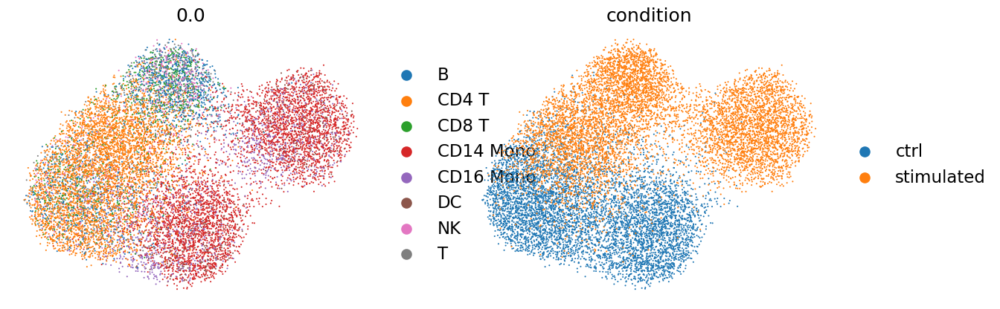

---UMAP for dis2p_cE_Z_0---


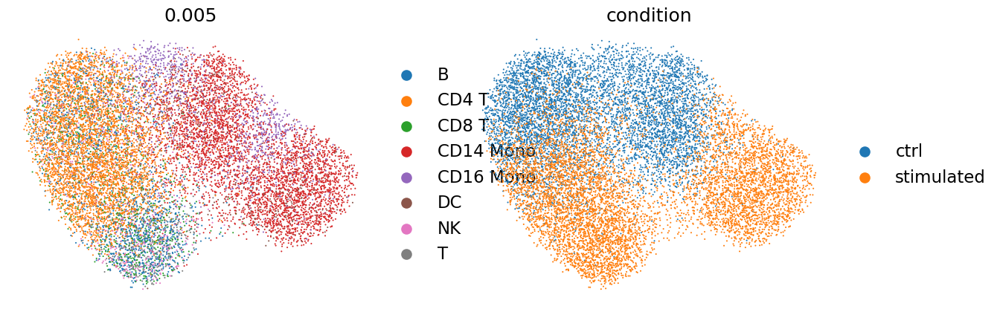

---UMAP for dis2p_cE_Z_0---


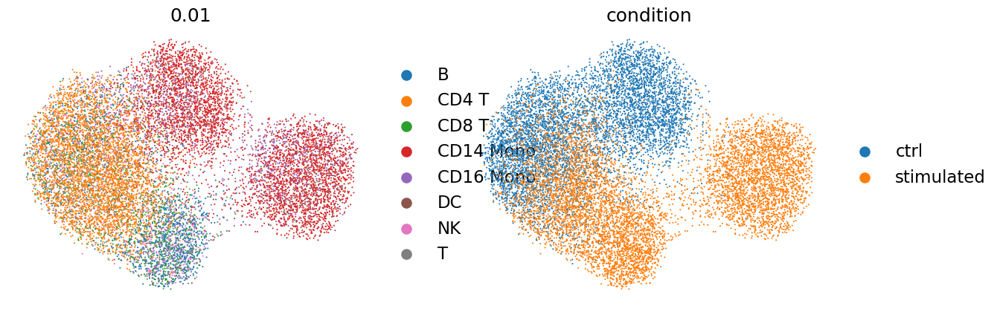

---UMAP for dis2p_cE_Z_0---


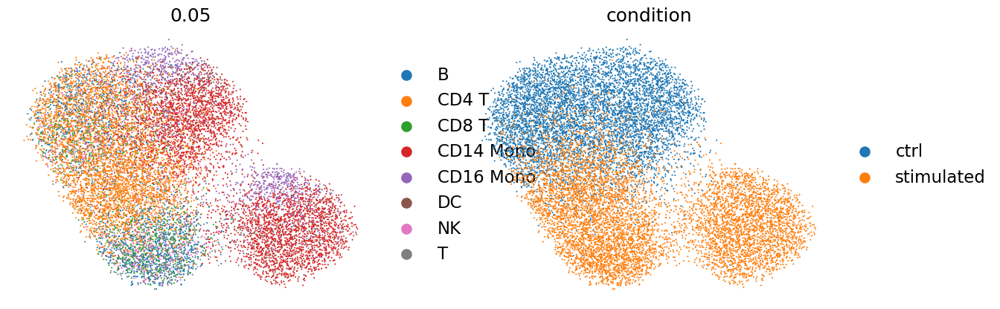

---UMAP for dis2p_cE_Z_0---


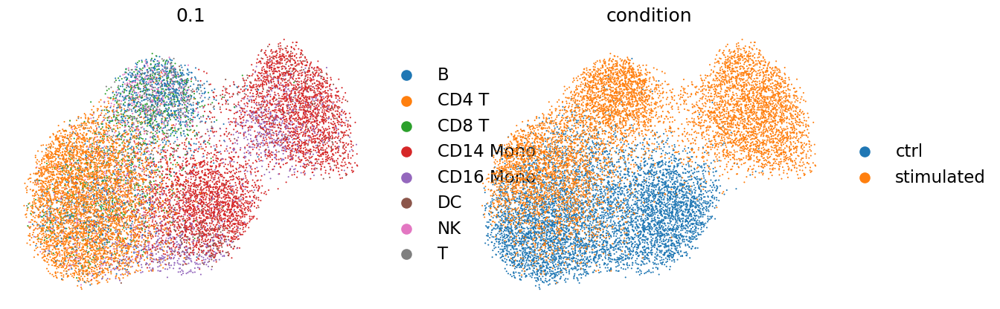

---UMAP for dis2p_cE_Z_0---


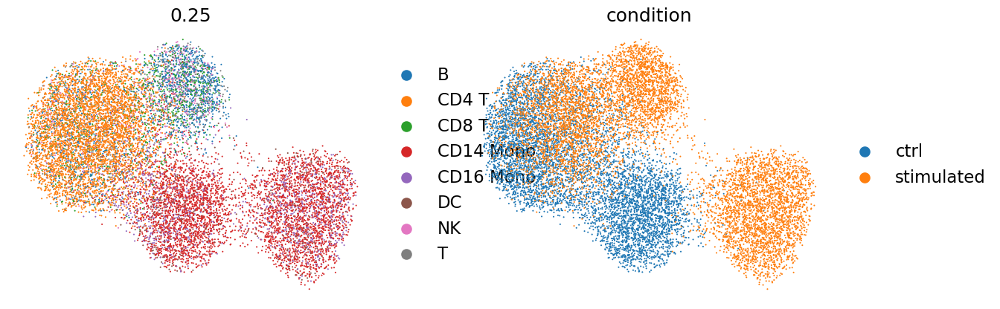

---UMAP for dis2p_cE_Z_0---


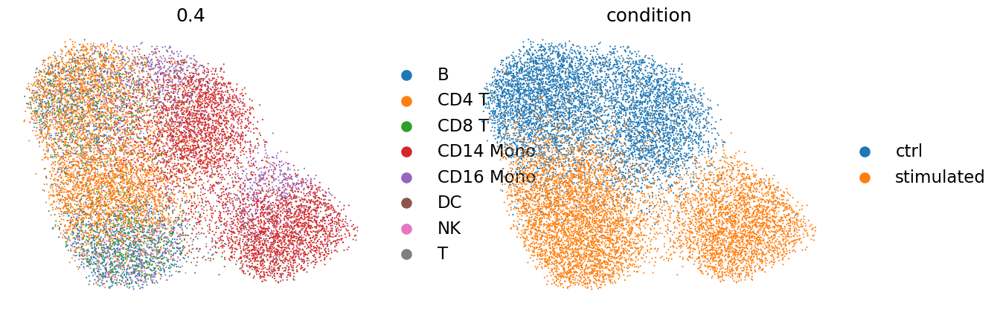

---UMAP for dis2p_cE_Z_0---


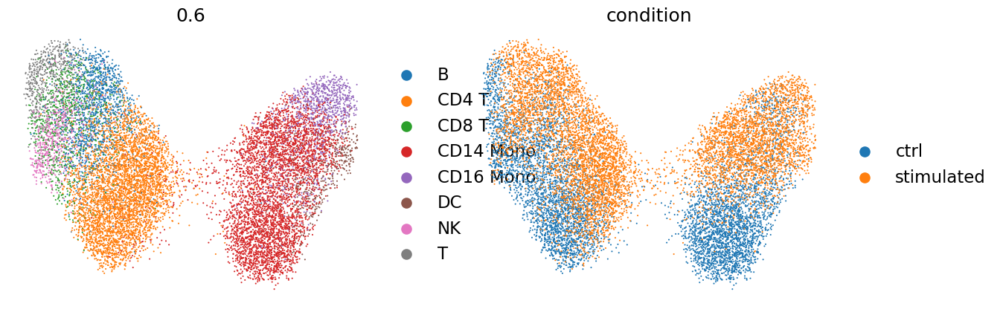

---UMAP for dis2p_cE_Z_0---


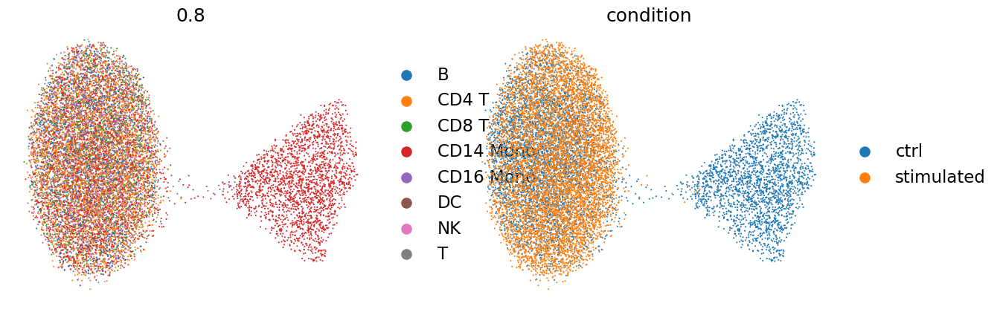

---UMAP for dis2p_cE_Z_0---


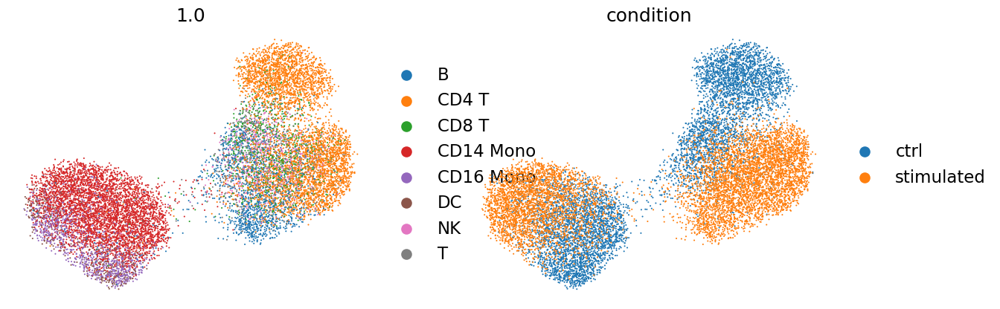

---UMAP for dis2p_cE_Z_0---


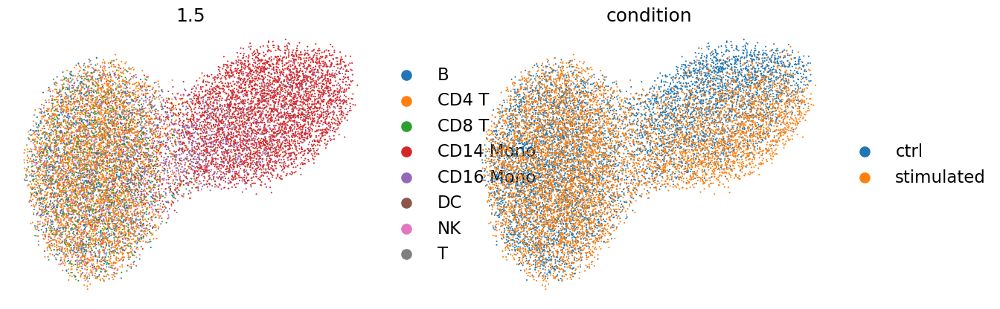

---UMAP for dis2p_cE_Z_0---


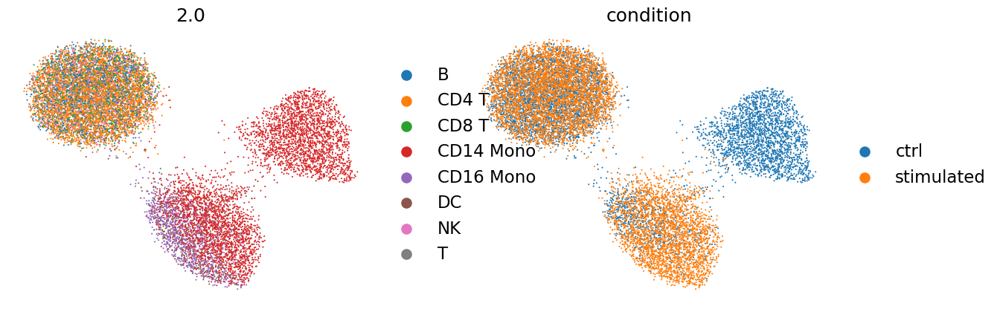

---UMAP for dis2p_cE_Z_0---


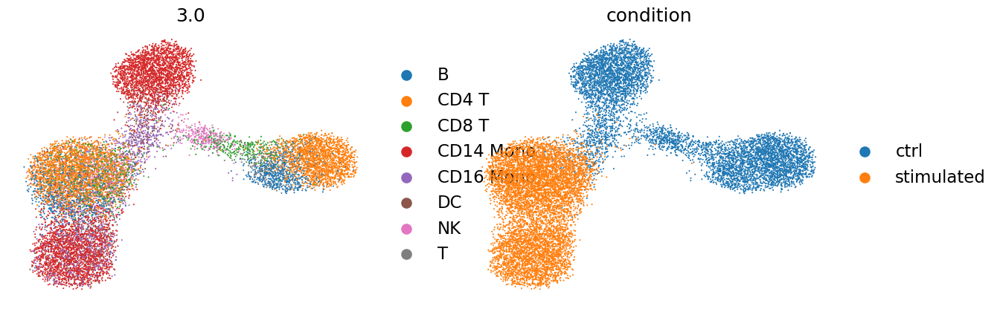

---UMAP for dis2p_cE_Z_0---


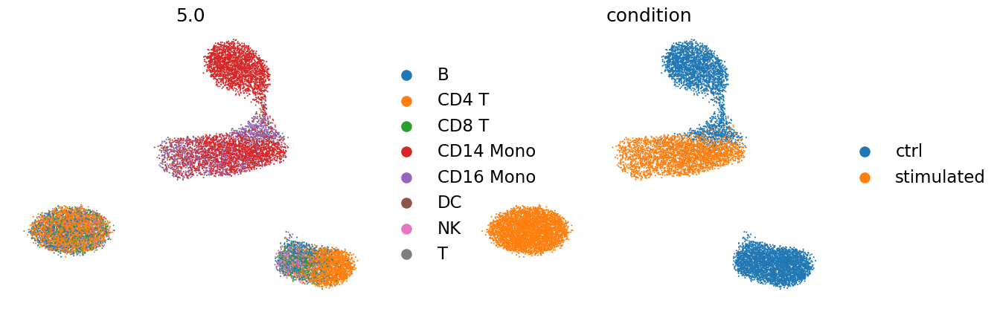

---UMAP for dis2p_cE_Z_0---


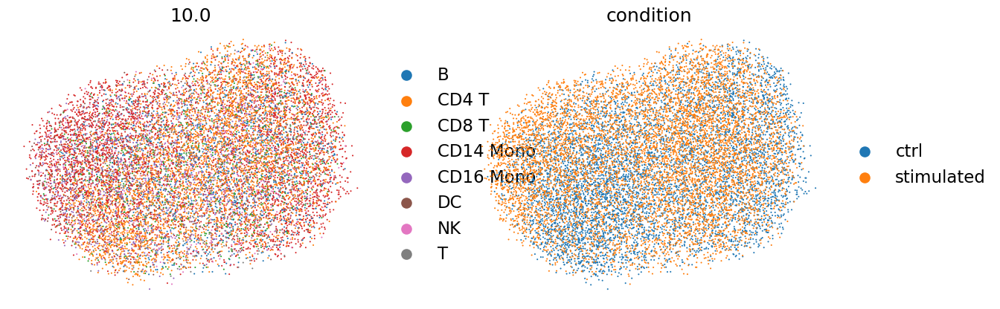

In [14]:
import warnings
warnings.filterwarnings("ignore")
random.seed(0)

nrow = len(cats) + 1
ncol = len(cats)
i = 0
for name, model in models.items():
    adata.obsm[f'celldisect_Z_0'] = model.get_latent_representation(nullify_cat_covs_indices=[s for s in range(len(cats))], nullify_shared=False)
    
    # adata.obsm[f'celldisect_Z_not_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=[i], nullify_shared=False)
    latent_name = f'celldisect_Z_0'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])

    sc.pp.neighbors(adata, use_rep=f"{latent_name}")
    sc.tl.umap(adata)
    sc.pl.umap(
        adata,
        color=cats,
        # ncols=len(cats_),
        frameon=False,
        # legend_loc=None,
        title=name,
        # ax=axs[i][:]
    )

---UMAP for dis2p_cE_Z_1---
cell_type


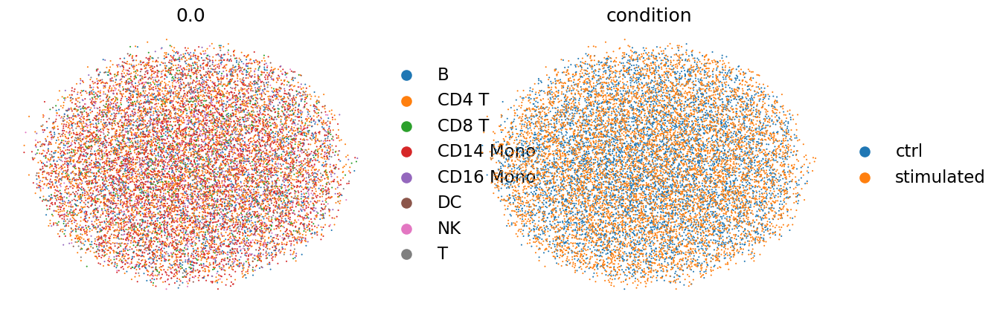

---UMAP for dis2p_cE_Z_1---
cell_type


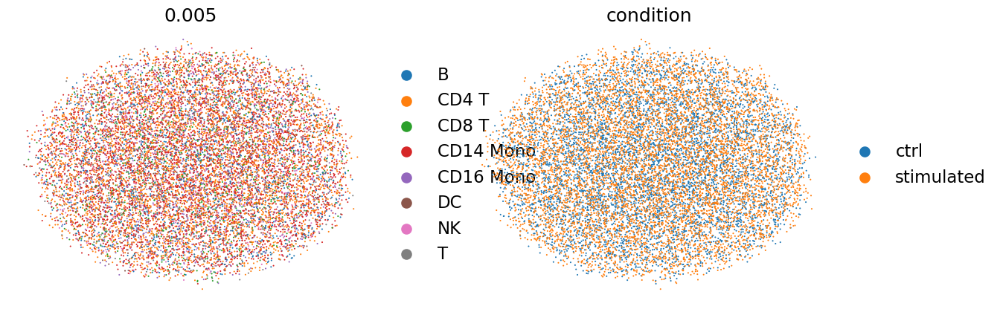

---UMAP for dis2p_cE_Z_1---
cell_type


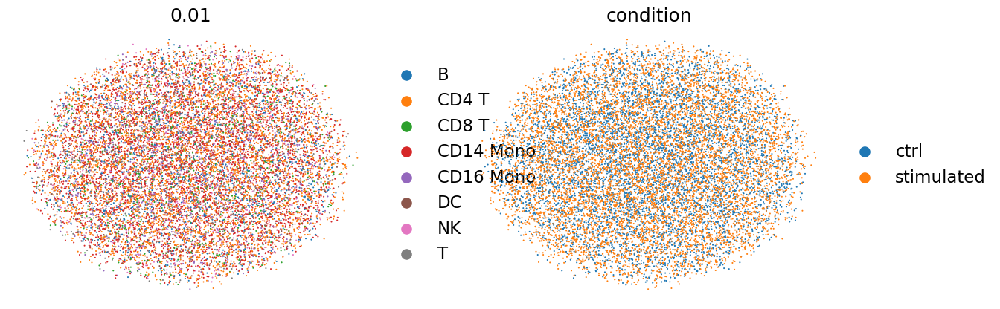

---UMAP for dis2p_cE_Z_1---
cell_type


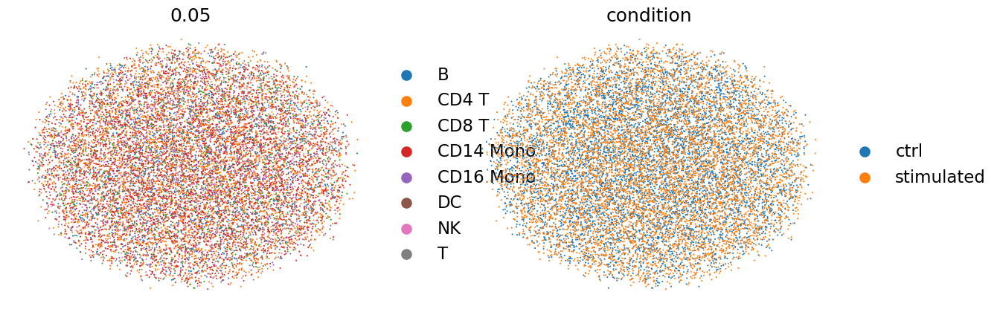

---UMAP for dis2p_cE_Z_1---
cell_type


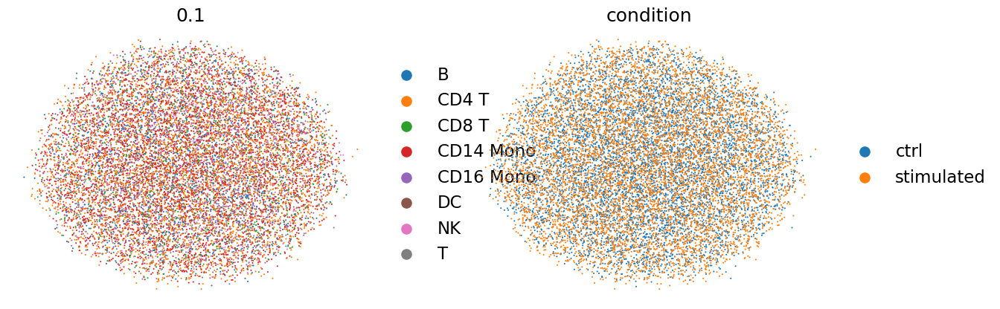

---UMAP for dis2p_cE_Z_1---
cell_type


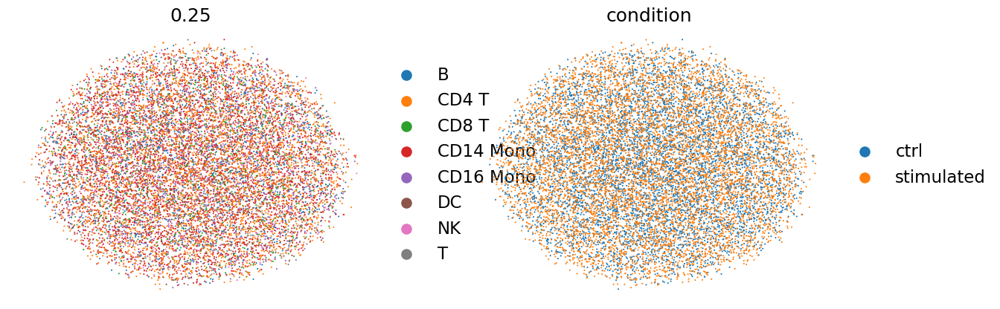

---UMAP for dis2p_cE_Z_1---
cell_type


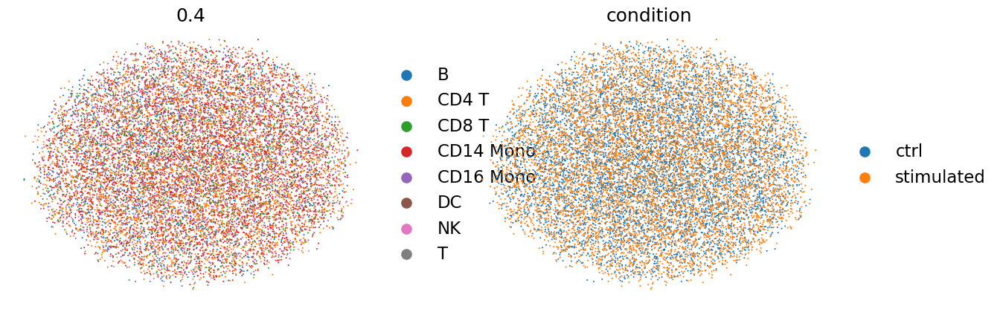

---UMAP for dis2p_cE_Z_1---
cell_type


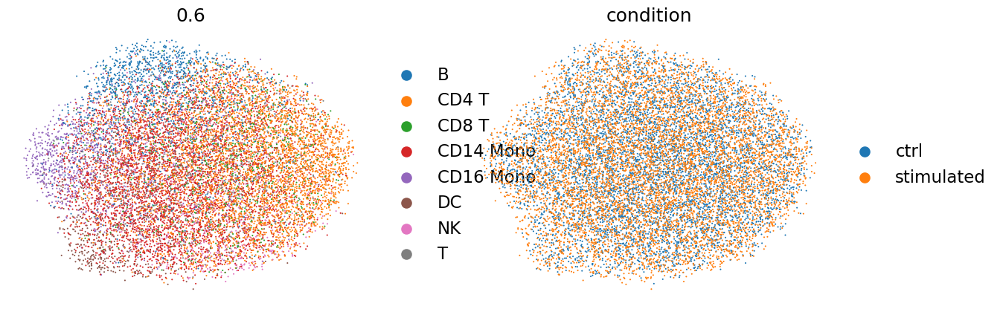

---UMAP for dis2p_cE_Z_1---
cell_type


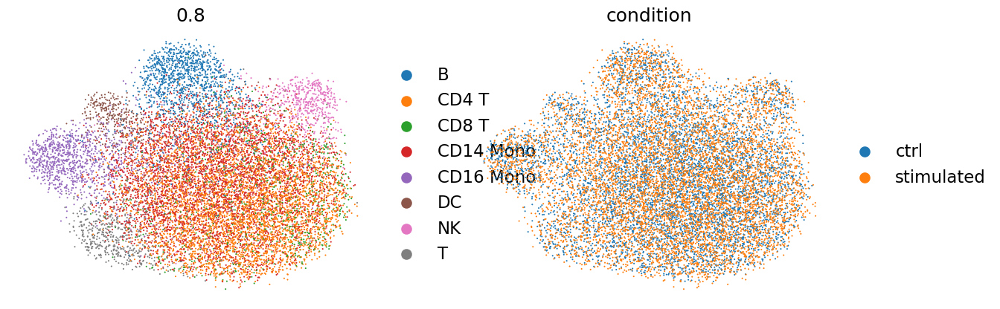

---UMAP for dis2p_cE_Z_1---
cell_type


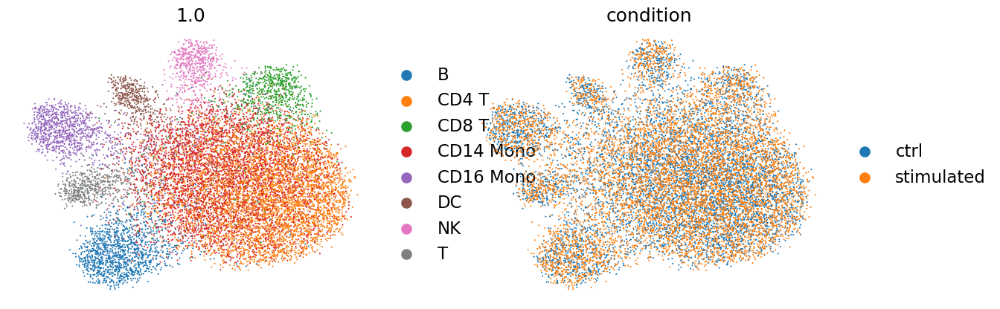

---UMAP for dis2p_cE_Z_1---
cell_type


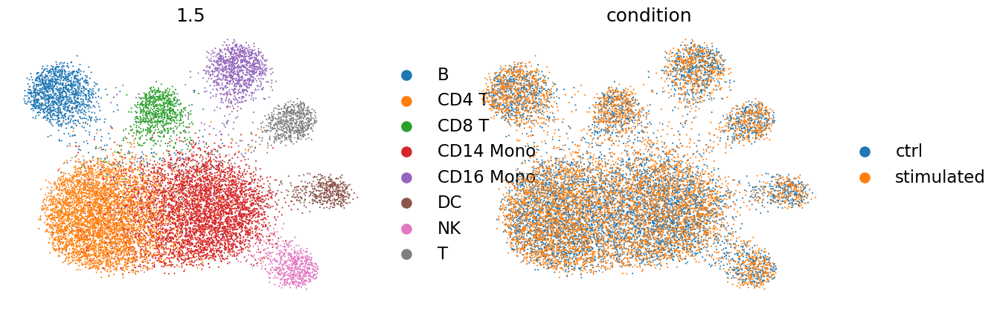

---UMAP for dis2p_cE_Z_1---
cell_type


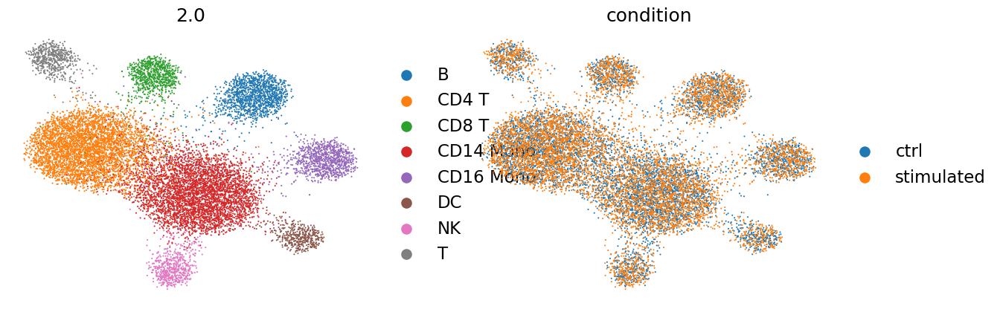

---UMAP for dis2p_cE_Z_1---
cell_type


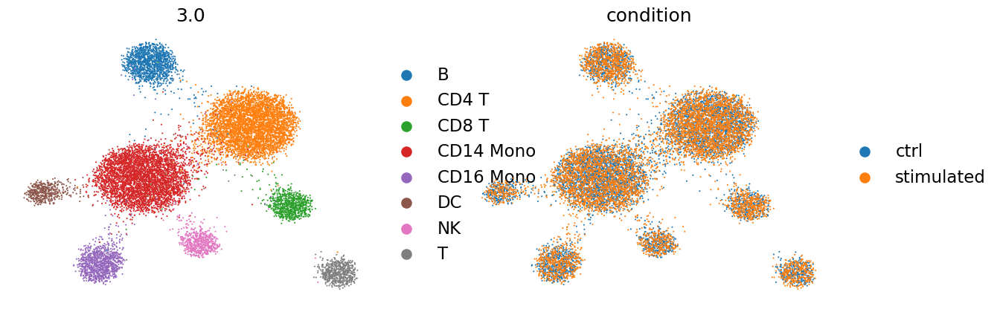

---UMAP for dis2p_cE_Z_1---
cell_type


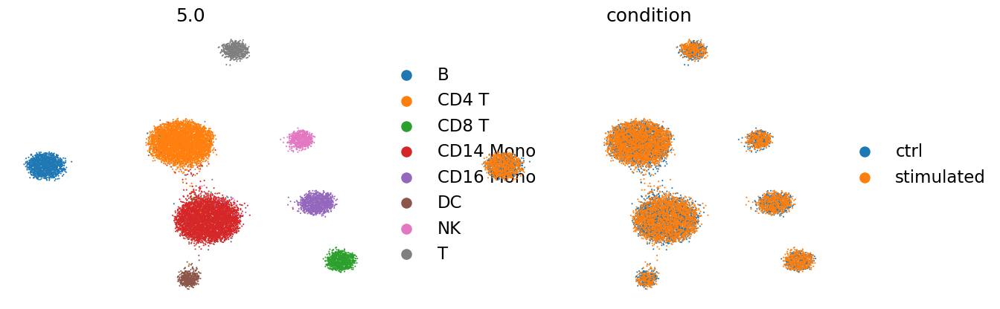

---UMAP for dis2p_cE_Z_1---
cell_type


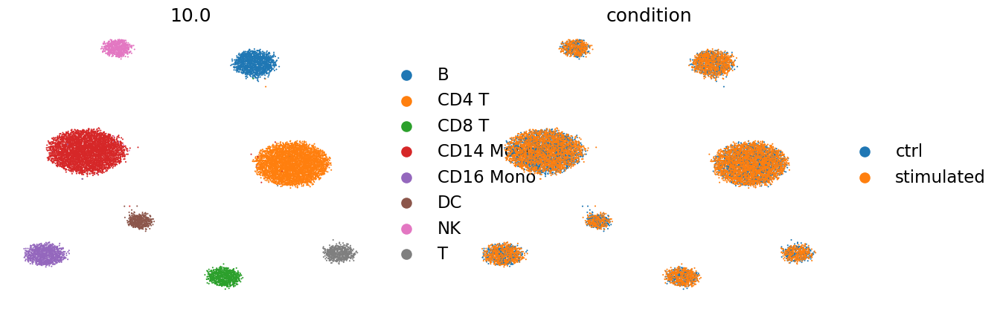

In [15]:
import warnings
warnings.filterwarnings("ignore")
random.seed(0)

nrow = len(cats) + 1
ncol = len(cats)
i = 1
for name, model in models.items():
    null_idx = [s for s in range(len(cats)) if s != (i-1)]
    # Z_i
    adata.obsm[f'celldisect_Z_{i}'] = model.get_latent_representation(nullify_cat_covs_indices=null_idx, nullify_shared=True)
    # Z_{-i}
    # adata.obsm[f'celldisect_Z_not_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=[i], nullify_shared=False)
    latent_name = f'celldisect_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])

    sc.pp.neighbors(adata, use_rep=f"{latent_name}")
    sc.tl.umap(adata)
    sc.pl.umap(
        adata,
        color=cats,
        # ncols=len(cats_),
        frameon=False,
        # legend_loc=None,
        title=name,
        # ax=axs[i][:]
    )

---UMAP for dis2p_cE_Z_2---
condition


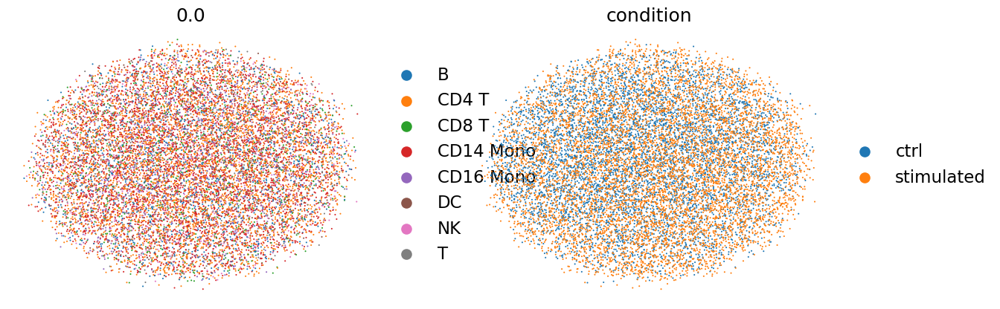

---UMAP for dis2p_cE_Z_2---
condition


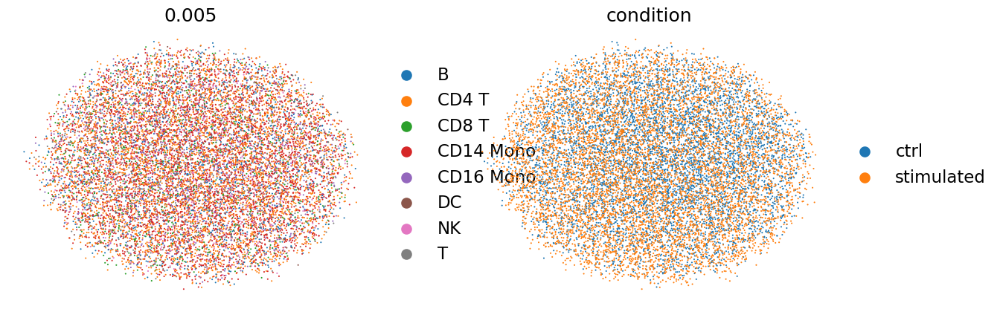

---UMAP for dis2p_cE_Z_2---
condition


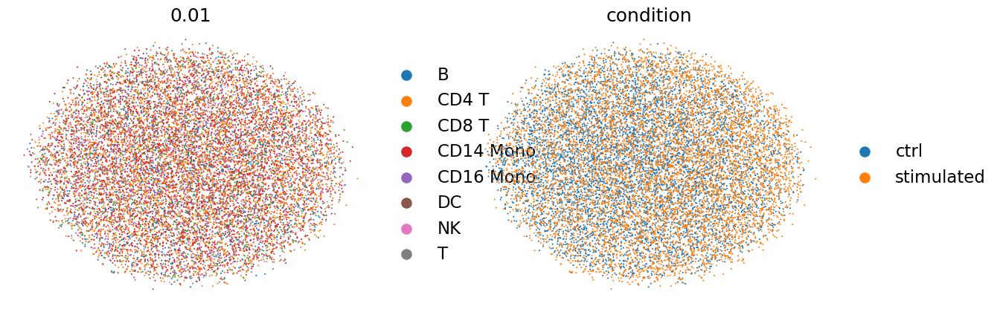

---UMAP for dis2p_cE_Z_2---
condition


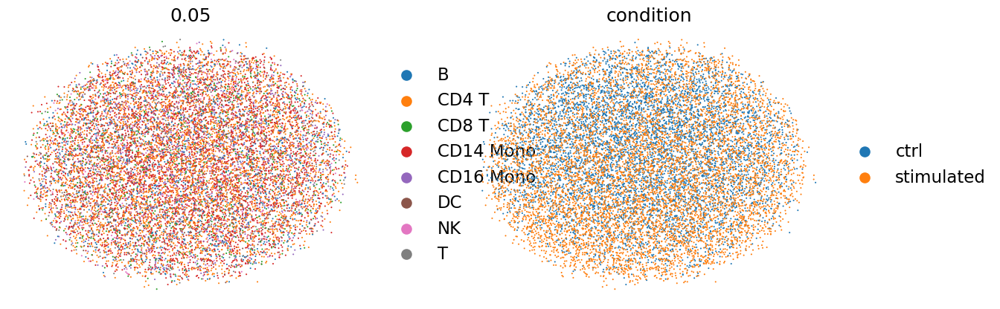

---UMAP for dis2p_cE_Z_2---
condition


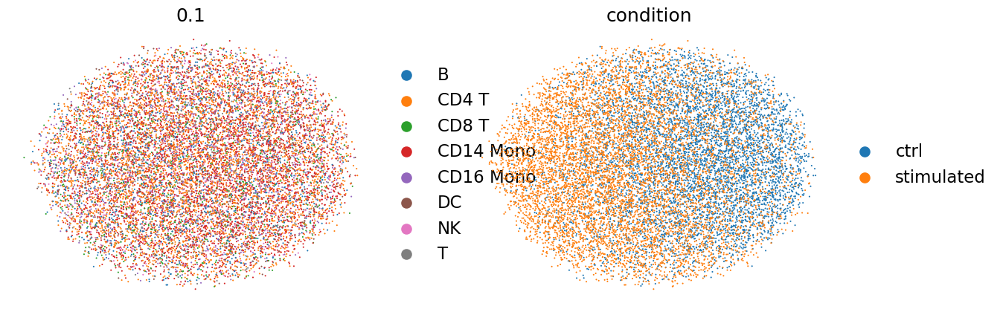

---UMAP for dis2p_cE_Z_2---
condition


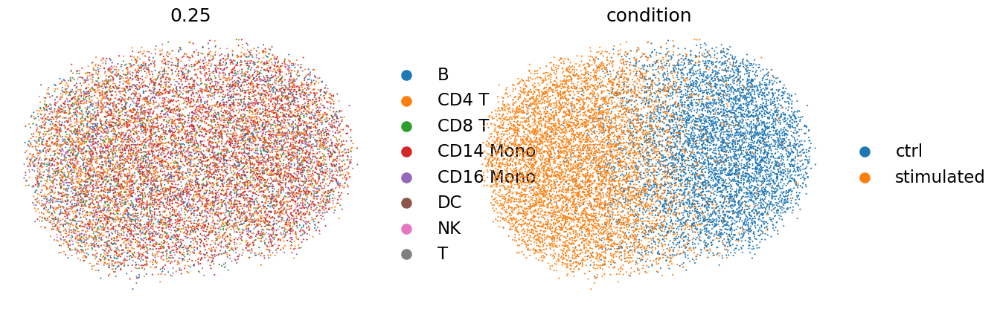

---UMAP for dis2p_cE_Z_2---
condition


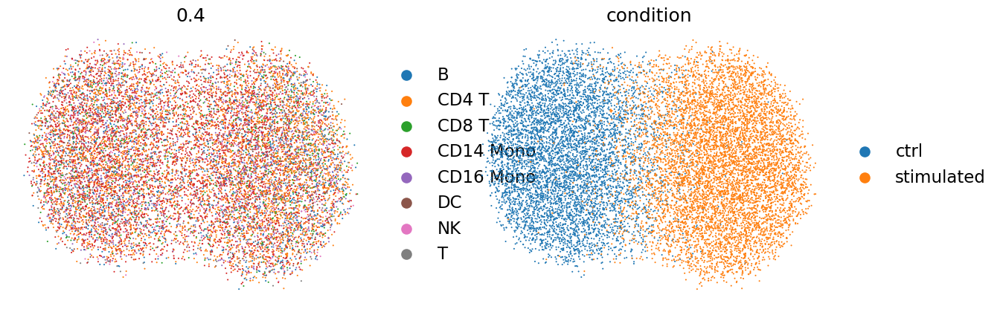

---UMAP for dis2p_cE_Z_2---
condition


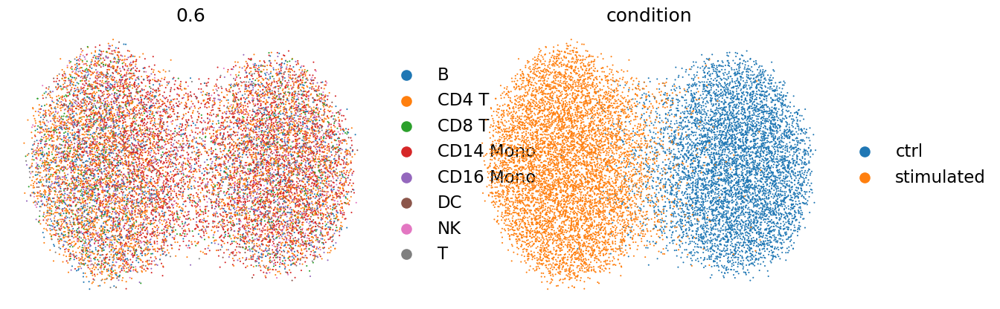

---UMAP for dis2p_cE_Z_2---
condition


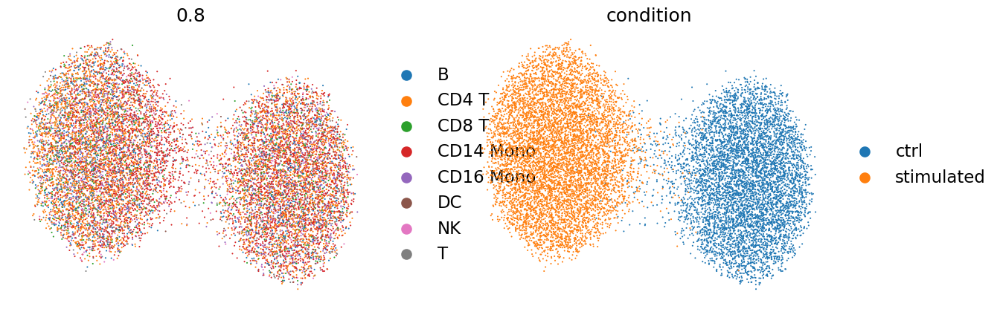

---UMAP for dis2p_cE_Z_2---
condition


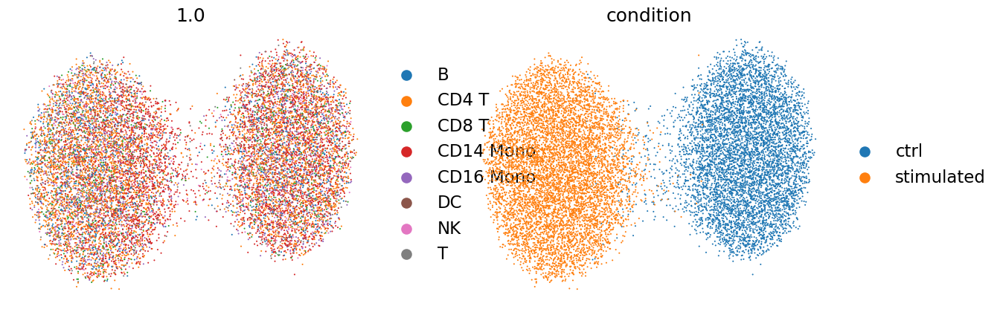

---UMAP for dis2p_cE_Z_2---
condition


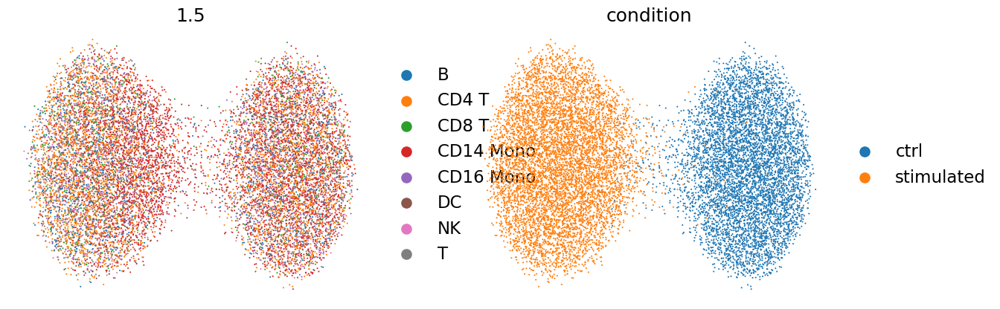

---UMAP for dis2p_cE_Z_2---
condition


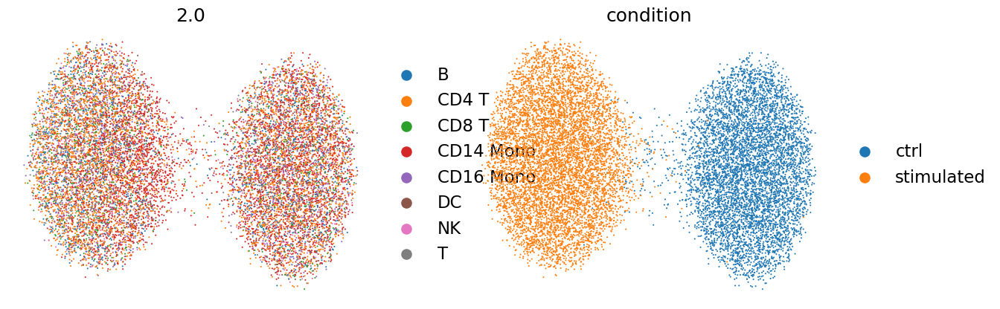

---UMAP for dis2p_cE_Z_2---
condition


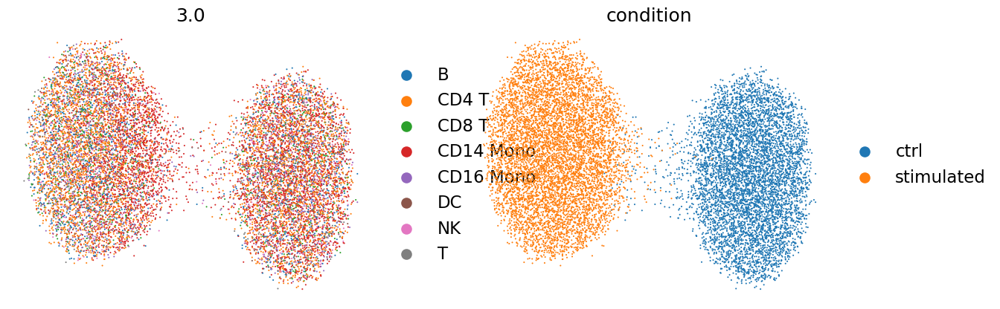

---UMAP for dis2p_cE_Z_2---
condition


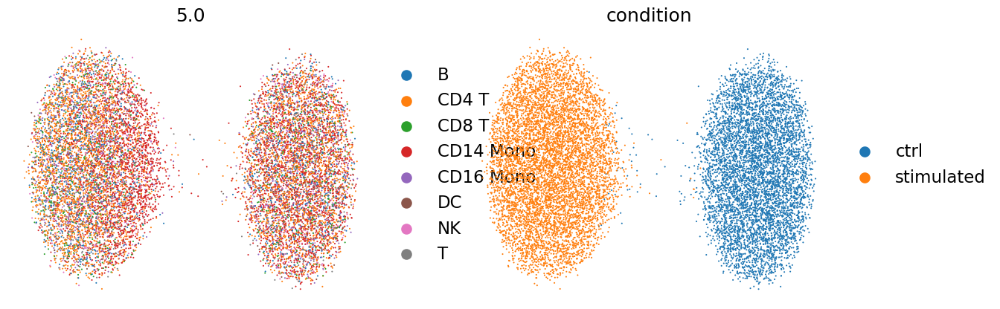

---UMAP for dis2p_cE_Z_2---
condition


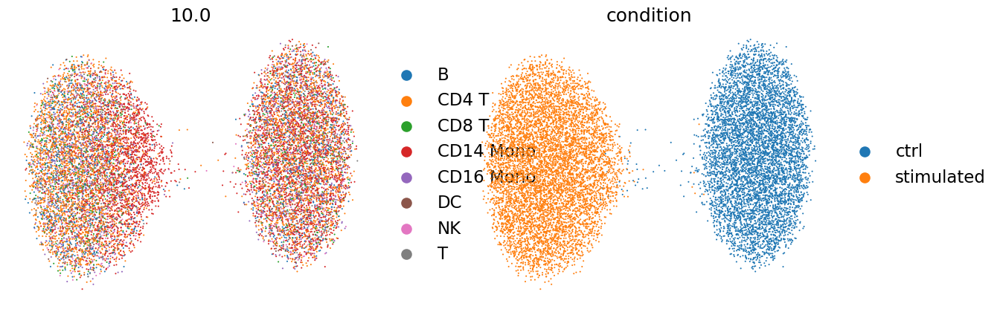

In [16]:
import warnings
warnings.filterwarnings("ignore")
random.seed(0)

nrow = len(cats) + 1
ncol = len(cats)
i = 2
for name, model in models.items():
    null_idx = [s for s in range(len(cats)) if s != (i-1)]
    # Z_i
    adata.obsm[f'celldisect_Z_{i}'] = model.get_latent_representation(nullify_cat_covs_indices=null_idx, nullify_shared=True)
    # Z_{-i}
    # adata.obsm[f'celldisect_Z_not_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=[i], nullify_shared=False)
    latent_name = f'celldisect_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])

    sc.pp.neighbors(adata, use_rep=f"{latent_name}")
    sc.tl.umap(adata)
    sc.pl.umap(
        adata,
        color=cats,
        # ncols=len(cats_),
        frameon=False,
        # legend_loc=None,
        title=name,
        # ax=axs[i][:]
    )

In [17]:
def pred_our_ood_avg(model,
                adata,  # OOD Adata
                cov_names,
                cov_values: str,
                cov_values_cf: str,
                cats: list[str],
                n_samples_from_source = None,
                n_samples: int = 1000,
                dec_b=0,
                dec_e=None):
    adata.X = adata.layers['counts'].copy()
    adata.obs['idx'] = [i for i in range(len(adata))]

    true_indices = pd.DataFrame([adata.obs[cov_name] == cov_values_cf[i] for i, cov_name in enumerate(cov_names)]).all(0).values
    true_idx = list(adata[true_indices].obs['idx'])
    
    source_indices = pd.DataFrame([adata.obs[cov_name] == cov_values[i] for i, cov_name in enumerate(cov_names)]).all(0).values
    source_idx = list(adata[source_indices].obs['idx'])

    true_adata = adata[adata.obs['idx'].isin(true_idx)].copy()
    source_adata = adata[adata.obs['idx'].isin(source_idx)].copy()

    if n_samples_from_source is not None:
        random.seed(0)
        chosen_ids = random.sample(range(len(source_adata)), n_samples_from_source)
        source_adata = source_adata[chosen_ids].copy()
    adata_cf = source_adata.copy()
        
    
    for i, cov_name in enumerate(cov_names):
        adata_cf.obs.loc[:, cov_name] = pd.Categorical(
            [cov_values_cf[i] for _ in adata_cf.obs[cov_name]])
    batch_size = len(adata_cf)
    device = 'cuda' if torch.cuda.is_available() else 'cpu'

    model.setup_anndata(
        adata_cf,
        layer='counts',
        categorical_covariate_keys=cats,
        continuous_covariate_keys=[]
    )
    adata_cf = model._validate_anndata(adata_cf)
    source_adata = model._validate_anndata(source_adata)
    # print("Data loader OOD")
    scdl_cf = model._make_data_loader(
        adata=adata_cf, batch_size=batch_size
    )
    scdl = model._make_data_loader(
        adata=source_adata, batch_size=batch_size
    )
    # cov_idx = cats.index(cov_name)
    px_cf_mean_list = []
    for tensors, tensors_cf in zip(scdl, scdl_cf):
        x, pxs_cf = model.module.sub_forward_cf_avg(
                            x=tensors[REGISTRY_KEYS.X_KEY].to(device),
                            cat_covs=tensors[REGISTRY_KEYS.CAT_COVS_KEY].to(device),
                            cat_covs_cf=tensors_cf[REGISTRY_KEYS.CAT_COVS_KEY].to(device))

        # for px_cf in pxs_cf:
        #     samples = []
        #     if px_cf is None:
        #         continue
        #     for _ in range(n_samples):
        #         samples.append(px_cf.sample().to('cpu'))
        #     samples = torch.stack(samples, dim=0)
        #     x_cf = torch.mean(samples, dim=0)
        #     print(samples.shape)
        #     print(x_cf.shape)
        #     px_cf_mean_list.append(x_cf)
        for px_cf in pxs_cf[dec_b: dec_e]:
            if px_cf is None:
                continue
            x_cf = px_cf.mu
            px_cf_mean_list.append(x_cf)
    if len(px_cf_mean_list) > 1:
        px_cf_mean_tensor = torch.stack(px_cf_mean_list, dim=0)
        px_cf_mean_pred = torch.mean(px_cf_mean_tensor, dim=0)
    else:
        px_cf_mean_tensor = px_cf_mean_list[0][None, :, :]
        px_cf_mean_pred = px_cf_mean_list[0]
    

    px_cf_mean_pred = px_cf_mean_pred.to('cpu').detach().numpy()
    px_cf_mean_tensor = px_cf_mean_tensor.to('cpu').detach().numpy()

    px_cf_mean_tensor = ad.AnnData(px_cf_mean_pred)
    px_cf_mean_tensor = torch.tensor(px_cf_mean_tensor.X)

    true_x_count = torch.tensor(true_adata.X)
    cf_x_count = torch.tensor(source_adata.X)

    x_true = true_x_count
    x_pred = px_cf_mean_tensor
    x_ctrl = cf_x_count

    x_true = np.log1p(x_true)
    x_pred = np.log1p(x_pred)
    x_ctrl = np.log1p(x_ctrl)
    return x_ctrl, x_true, x_pred, px_cf_mean_tensor, true_x_count

In [18]:
# cell_type_to_check = ['CD4 T',]
# cell_type_to_check = ['B',]
cell_type_to_check = ['CD14 Mono']

cov_names = ['condition']
cov_values = ['ctrl']
cov_values_cf = ['stimulated']
n_samples_from_source = None

In [19]:
preds = {}
for name, model in models.items():
    x_ctrl, x_true, x_pred, _, _ = pred_our_ood_avg(model,
                                              adata[adata.obs['cell_type'] == cell_type_to_check[0]].copy(),
                                              cov_names=cov_names,
                                              cov_values=cov_values,
                                              cov_values_cf=cov_values_cf,
                                              cats=cats,
                                              n_samples_from_source=None,
                                              dec_b=0,
                                              dec_e=None,
                                             )
    preds[name] = x_pred

INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer setup.                                        
INFO     AnnData object appears to be a copy. Attempting to transfer set

In [20]:
adata.X = adata.layers['counts'].copy()
sc.pp.log1p(adata)
adata.obs['cov_condition'] = adata.obs['cell_type'].astype(str) + '_' + adata.obs.condition.astype(str)

groupby='cov_condition'
control_group='ctrl'
key_added="rank_genes_groups_pval0.05"
n_genes=200
return_dict=False
rankby_abs=True
gene_dict = {}
covariate = 'cell_type'
cov_categories = adata.obs[covariate].unique()
for cov_cat in cov_categories:
    print(cov_cat)
    # name of the control group in the groupby obs column
    control_group_cov = "_".join([cov_cat, control_group])
    adata_cov = adata[adata.obs[covariate] == cov_cat]

    sc.tl.rank_genes_groups(
        adata_cov,
        groupby=groupby,
        reference=control_group_cov,
        rankby_abs=rankby_abs,
        n_genes=n_genes,
        use_raw=False,
        method='wilcoxon',
    )

    de_genes_groups = pd.DataFrame(adata_cov.uns["rank_genes_groups"]["names"]).columns

    de_genes = {}
    lfc = {}
    for group in de_genes_groups:
        # de_genes[group] = sc.get.rank_genes_groups_df(adata_cov, group, key='rank_genes_groups', pval_cutoff=None, log2fc_min=None, log2fc_max=None)['names']
        de_genes[group] = sc.get.rank_genes_groups_df(adata_cov, group, key='rank_genes_groups', pval_cutoff=0.05, log2fc_min=None, log2fc_max=None)['names']
        lfc[group] = sc.get.rank_genes_groups_df(adata_cov, group, key='rank_genes_groups', pval_cutoff=0.05, log2fc_min=None, log2fc_max=None)['logfoldchanges']

        lfc_indices = lfc[group].abs().sort_values(ascending=False).index
        de_genes[group] = de_genes[group][lfc_indices].reset_index(drop=True)

        gene_dict[group] = de_genes[group].tolist()

adata.uns[key_added] = gene_dict
adata.X = adata.layers['counts'].copy()

CD14 Mono
CD4 T
T
CD8 T
B
DC
CD16 Mono
NK


In [28]:
adata.uns[key_added]['CD4 T_stimulated'][:10]

['CCL8',
 'CXCL10',
 'IFIT3',
 'IFIT1',
 'IFIT2',
 'RSAD2',
 'LAMP3',
 'IFI6',
 'APOBEC3A',
 'CMPK2']

In [21]:
# deg_list = adata.uns[key_added]['CD4 T_stimulated']
deg_list = adata.uns[key_added]['CD14 Mono_stimulated']
# deg_list = adata.uns['rank_genes_groups_split_CD4T']['B_stimulated']
r2_results = {}
for n_top_deg in [10, 20, 40, 50, 100, 150, 200, None]:
    if n_top_deg is not None:
        degs = np.where(np.isin(adata.var_names, deg_list[:n_top_deg]))[0]
    else:
        degs = np.arange(adata.n_vars)
        n_top_deg = 'all'

    x_true_deg = x_true[:, degs]
    x_degs = [pred[:, degs] for pred in preds.values()]

    r2_means = [pearsonr(x_true_deg.mean(0), x_pred_deg.mean(0)) for x_pred_deg in x_degs]
    
    r2_vars = [pearsonr(x_true_deg.var(0), x_pred_deg.var(0)) for x_pred_deg in x_degs]
    
    r2_results[str(n_top_deg)] = {}
    for i, name in enumerate(preds.keys()):
        r2_results[str(n_top_deg)][name] = r2_means[i][0]
        # r2_results[str(n_top_deg)][name + '_var'] = r2_vars[i][0]

r2_results = pd.DataFrame.from_dict(r2_results).T

# #######################################################################
# r2_results_subtract = {}
# for n_top_deg in [10, 20, 40, 50, 100, 150, 200, None]:
#     if n_top_deg is not None:
#         degs = np.where(np.isin(adata.var_names, deg_list[:n_top_deg]))[0]
#     else:
#         degs = np.arange(adata.n_vars)
#         n_top_deg = 'all'

#     x_true_deg = x_true[:, degs]
#     x_pred_deg = x_pred[:, degs]
#     x_ctrl_deg = x_ctrl[:, degs]
#     x_biolord_deg = x_biolord[:, degs]
#     x_scdisinfact_deg = x_scdisinfact[:, degs]
    

#     r2_mean_deg = pearsonr(x_true_deg.mean(0) - x_ctrl_deg.mean(0), x_pred_deg.mean(0) - x_ctrl_deg.mean(0))
#     r2_mean_biolord_deg = pearsonr(x_true_deg.mean(0) - x_ctrl_deg.mean(0), x_biolord_deg.mean(0) - x_ctrl_deg.mean(0))
#     r2_mean_scdisinfact_deg = pearsonr(x_true_deg.mean(0) - x_ctrl_deg.mean(0), x_scdisinfact_deg.mean(0) - x_ctrl_deg.mean(0))
    
#     r2_var_deg = pearsonr(x_true_deg.var(0) - x_ctrl_deg.var(0), x_pred_deg.var(0) - x_ctrl_deg.var(0))
#     r2_var_biolord_deg = pearsonr(x_true_deg.var(0) - x_ctrl_deg.var(0), x_biolord_deg.var(0) - x_ctrl_deg.var(0))
#     r2_var_scdisinfact_deg = pearsonr(x_true_deg.var(0) - x_ctrl_deg.var(0), x_scdisinfact_deg.var(0) - x_ctrl_deg.var(0))
    
#     r2_results_subtract[str(n_top_deg)] = {}
#     r2_results_subtract[str(n_top_deg)]['Prediction'] = r2_mean_deg[0]
#     r2_results_subtract[str(n_top_deg)]['Biolord'] = r2_mean_biolord_deg[0]
#     r2_results_subtract[str(n_top_deg)]['scdisinfact'] = r2_mean_scdisinfact_deg[0]

#     r2_results_subtract[str(n_top_deg)]['Prediction_var'] = r2_var_deg[0]
#     r2_results_subtract[str(n_top_deg)]['Biolord_var'] = r2_var_biolord_deg[0]
#     r2_results_subtract[str(n_top_deg)]['scdisinfact_var'] = r2_var_scdisinfact_deg[0]
    
# r2_results_subtract = pd.DataFrame.from_dict(r2_results_subtract).T

In [22]:
# preds.keys()
r2_results

,0.0,0.005,0.01,0.05,0.1,0.25,0.4,0.6,0.8,1.0,1.5,2.0,3.0,5.0,10.0
10,0.761907,0.728745,0.744814,0.781720,0.776375,0.783631,0.744077,0.735735,0.822545,0.783120,0.797351,0.793817,0.752672,0.783000,0.800741
20,0.417463,0.395253,0.420496,0.449587,0.460356,0.465624,0.394552,0.533039,0.762435,0.713148,0.735959,0.696275,0.635987,0.669137,0.719249
40,0.392128,0.366937,0.383339,0.400173,0.400894,0.402163,0.362591,0.384399,0.694629,0.682156,0.675641,0.650918,0.593738,0.634751,0.655188
50,0.355850,0.315879,0.338224,0.356781,0.355701,0.358431,0.324871,0.291686,0.667726,0.661318,0.647062,0.639297,0.561994,0.609977,0.628947
100,0.275247,0.259266,0.269898,0.257326,0.267619,0.282511,0.255306,0.169467,0.628161,0.603229,0.584907,0.591495,0.504583,0.516671,0.541636
150,0.216042,0.215190,0.222392,0.202423,0.203541,0.220280,0.211844,0.142342,0.563039,0.579570,0.551893,0.550461,0.484699,0.463761,0.510955
200,0.375486,0.374369,0.376151,0.369610,0.369286,0.372308,0.374051,0.293379,0.513253,0.484690,0.499235,0.469249,0.477816,0.465180,0.481662
all,0.119533,0.122341,0.122722,0.126466,0.120592,0.118211,0.127381,0.078016,0.433392,0.413333,0.405318,0.391488,0.366373,0.366537,0.399664


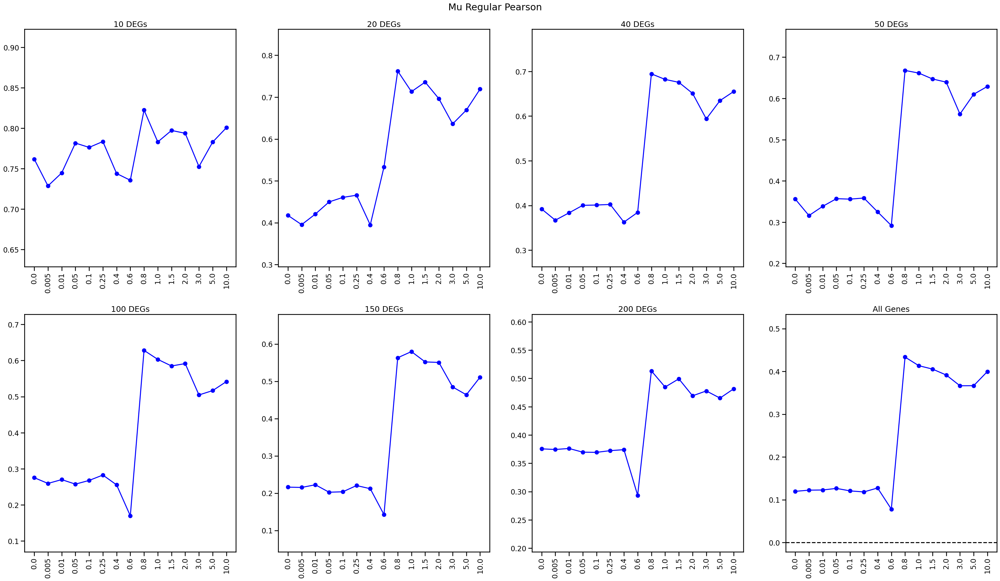

In [23]:
n_rows = r2_results.shape[0]
df = r2_results

fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(40, 12))

for i in range(n_rows):
    row = df.iloc[i]
    ax = axes[i // 4, i % 4] 
    
    # Line plot instead of bar plot
    ax.plot(range(len(row)), row, marker='o', linestyle='-', color='blue')

    ax.axhline(y=0, color='black', linestyle='--')  # Baseline

    # Value labels above the points (adjust 'y' for vertical position)
    # for x, y in enumerate(row):
        # ax.text(x, y + 0.05, f'{y:.4f}', ha='center', va='bottom', fontsize=15)  

    ax.set_xticks(range(len(row)))
    ax.set_xticklabels(df.columns, rotation=90)
    ax.set_ylim(row.min() - 0.1, row.max() + 0.1)  

    if r2_results.index[i] == 'all':
        ax.set_title('All Genes')
    else:
        ax.set_title(f'{r2_results.index[i]} DEGs')

fig.suptitle('Mu Regular Pearson', y = 1.57)
plt.subplots_adjust(top=1.5)
plt.show()


In [24]:
import scib

In [25]:
asw_results = {}
for name, model in models.items():
    # Z_0
    adata.obsm[f'celldisect_Z_0'] = model.get_latent_representation(nullify_cat_covs_indices=[s for s in range(len(cats))], nullify_shared=False)

    for i in range(len(cats)):
        null_idx = [s for s in range(len(cats)) if s != i]
        # Z_i
        adata.obsm[f'celldisect_Z_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=null_idx, nullify_shared=True)
        # Z_{-i}
        # adata.obsm[f'celldisect_Z_not_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=[i], nullify_shared=False)
    asw_results[name] = {}
    for i in range(len(cats)):
        label_key = cats[i]
        asw_results[name]['bio'] = scib.metrics.silhouette(adata, label_key, f'celldisect_Z_{i+1}', metric='euclidean', scale=True)
        for j in range(len(cats)):
            if j == i:
                continue
            label_key = cats[j]
            asw_results[name]['batch'] = scib.metrics.silhouette(adata, label_key, f'celldisect_Z_{i+1}', metric='euclidean', scale=True)

In [26]:
asw_results = pd.DataFrame(asw_results)
asw_results

,0.0,0.005,0.01,0.05,0.1,0.25,0.4,0.6,0.8,1.0,1.5,2.0,3.0,5.0,10.0
bio,0.501578,0.501942,0.501793,0.502004,0.506354,0.523926,0.538862,0.551952,0.580025,0.584268,0.591342,0.597172,0.605423,0.614511,0.626955
batch,0.494638,0.493827,0.494567,0.493692,0.493797,0.492052,0.492649,0.493197,0.494423,0.494093,0.493754,0.493247,0.493193,0.491282,0.491757


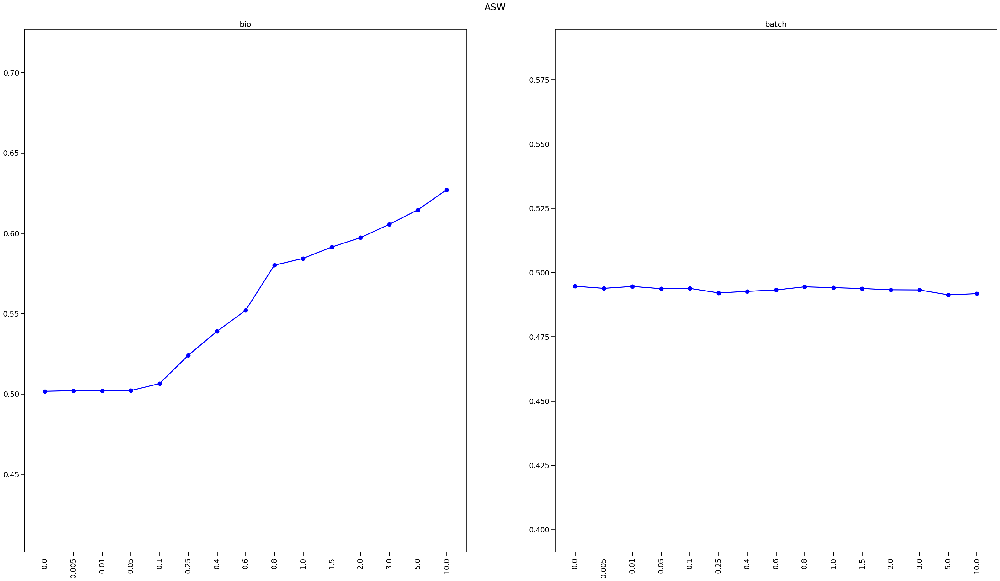

In [27]:
n_rows = asw_results.shape[0]
df = asw_results

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(40, 12))

for i in range(2):
    row = df.iloc[i]
    ax = axes[i] 
    
    # Line plot instead of bar plot
    ax.plot(range(len(row)), row, marker='o', linestyle='-', color='blue')

    ax.axhline(y=0, color='black', linestyle='--')  # Baseline

    # Value labels above the points (adjust 'y' for vertical position)
    # for x, y in enumerate(row):
        # ax.text(x, y + 0.05, f'{y:.4f}', ha='center', va='bottom', fontsize=15)  

    ax.set_xticks(range(len(row)))
    ax.set_xticklabels(df.columns, rotation=90)
    ax.set_ylim(row.min() - 0.1, row.max() + 0.1)  


    ax.set_title(f'{df.index[i]}')

fig.suptitle('ASW', y = 1.57)
plt.subplots_adjust(top=1.5)
plt.show()